# Instructions

+ Run the program step by step+ Place the data set on the same folder where the jupyter notebook is 

# Prerequisite 

+ Install the required modules for machine learning if already not installed 

In [1]:
!pip install pandas numpy matplotlib seaborn scikit-learn


[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.datasets import make_blobs
from sklearn.preprocessing import StandardScaler

C:\Users\DELL\AppData\Local\Temp\ipykernel_9012\1658952023.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


# Data Loading & Processing 

+ Data loading 
+ Data Processing
    + Normalization - As mentioned on dataset it's already scaled [-1,1]
    + Handling Outliers
    + Handling Categorical Features - There is one categorical feature Y which is already encoded into number
    + Handling Missing Data - There is no missing values 
    + Data Exploration - Data is visualized 

In [3]:
x_file_path = 'X_train.txt' 
y_file_path = 'y_train.txt'
X = pd.read_fwf(x_file_path, header=None)
y = pd.read_fwf(y_file_path, header=None)
df = pd.concat([X, y], axis=1)
df.columns = range(df.shape[1])

In [4]:
df.head(10)

,0,1,2,3,4,5,6,7,8,9,...,552,553,554,555,556,557,558,559,560,561
0,0.288585,-0.020294,-0.132905,-0.995279,-0.983111,-0.913526,-0.995112,-0.983185,-0.923527,-0.934724,...,-0.298676,-0.710304,-0.112754,0.030400,-0.464761,-0.018446,-0.841247,0.179941,-0.058627,5
1,0.278419,-0.016411,-0.123520,-0.998245,-0.975300,-0.960322,-0.998807,-0.974914,-0.957686,-0.943068,...,-0.595051,-0.861499,0.053477,-0.007435,-0.732626,0.703511,-0.844788,0.180289,-0.054317,5
2,0.279653,-0.019467,-0.113462,-0.995380,-0.967187,-0.978944,-0.996520,-0.963668,-0.977469,-0.938692,...,-0.390748,-0.760104,-0.118559,0.177899,0.100699,0.808529,-0.848933,0.180637,-0.049118,5
3,0.279174,-0.026201,-0.123283,-0.996091,-0.983403,-0.990675,-0.997099,-0.982750,-0.989302,-0.938692,...,-0.117290,-0.482845,-0.036788,-0.012892,0.640011,-0.485366,-0.848649,0.181935,-0.047663,5
4,0.276629,-0.016570,-0.115362,-0.998139,-0.980817,-0.990482,-0.998321,-0.979672,-0.990441,-0.942469,...,-0.351471,-0.699205,0.123320,0.122542,0.693578,-0.615971,-0.847865,0.185151,-0.043892,5
5,0.277199,-0.010098,-0.105137,-0.997335,-0.990487,-0.995420,-0.997627,-0.990218,-0.995549,-0.942469,...,-0.545410,-0.844619,0.082632,-0.143439,0.275041,-0.368224,-0.849632,0.184823,-0.042126,5
6,0.279454,-0.019641,-0.110022,-0.996921,-0.967186,-0.983118,-0.997003,-0.966097,-0.983116,-0.940987,...,-0.217198,-0.564430,-0.212754,-0.230622,0.014637,-0.189512,-0.852150,0.182170,-0.043010,5
7,0.277432,-0.030488,-0.125360,-0.996559,-0.966728,-0.981585,-0.996485,-0.966313,-0.982982,-0.940987,...,-0.082307,-0.421715,-0.020888,0.593996,-0.561871,0.467383,-0.851017,0.183779,-0.041976,5
8,0.277293,-0.021751,-0.120751,-0.997328,-0.961245,-0.983672,-0.997596,-0.957236,-0.984379,-0.940598,...,-0.269401,-0.572995,0.012954,0.080936,-0.234313,0.117797,-0.847971,0.188982,-0.037364,5
9,0.280586,-0.009960,-0.106065,-0.994803,-0.972758,-0.986244,-0.995405,-0.973663,-0.985642,-0.940028,...,0.339526,0.140452,-0.020590,-0.127730,-0.482871,-0.070670,-0.848294,0.190310,-0.034417,5


In [5]:
df.shape

(7352, 562)

In [6]:
df.describe

<bound method NDFrame.describe of            0         1         2         3         4         5         6    \
0     0.288585 -0.020294 -0.132905 -0.995279 -0.983111 -0.913526 -0.995112   
1     0.278419 -0.016411 -0.123520 -0.998245 -0.975300 -0.960322 -0.998807   
2     0.279653 -0.019467 -0.113462 -0.995380 -0.967187 -0.978944 -0.996520   
3     0.279174 -0.026201 -0.123283 -0.996091 -0.983403 -0.990675 -0.997099   
4     0.276629 -0.016570 -0.115362 -0.998139 -0.980817 -0.990482 -0.998321   
...        ...       ...       ...       ...       ...       ...       ...   
7347  0.299665 -0.057193 -0.181233 -0.195387  0.039905  0.077078 -0.282301   
7348  0.273853 -0.007749 -0.147468 -0.235309  0.004816  0.059280 -0.322552   
7349  0.273387 -0.017011 -0.045022 -0.218218 -0.103822  0.274533 -0.304515   
7350  0.289654 -0.018843 -0.158281 -0.219139 -0.111412  0.268893 -0.310487   
7351  0.351503 -0.012423 -0.203867 -0.269270 -0.087212  0.177404 -0.377404   

           7         8       

In [7]:
df.columns

RangeIndex(start=0, stop=562, step=1)

In [8]:
df.dtypes

0      float64
1      float64
2      float64
3      float64
4      float64
        ...   
557    float64
558    float64
559    float64
560    float64
561      int64
Length: 562, dtype: object

In [9]:
missing_values = df.isnull().sum()
columns_with_missing_values = missing_values[missing_values > 0]

if columns_with_missing_values.any():
    print("Columns with Missing Values:")
    print(columns_with_missing_values)
else:
    print("No missing values in any column.")


No missing values in any column.


In [10]:
df.describe()

,0,1,2,3,4,5,6,7,8,9,...,552,553,554,555,556,557,558,559,560,561
count,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,...,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000,7352.000000
mean,0.274488,-0.017695,-0.109141,-0.605438,-0.510938,-0.604754,-0.630512,-0.526907,-0.606150,-0.468604,...,-0.307009,-0.625294,0.008684,0.002186,0.008726,-0.005981,-0.489547,0.058593,-0.056515,3.643362
std,0.070261,0.040811,0.056635,0.448734,0.502645,0.418687,0.424073,0.485942,0.414122,0.544547,...,0.321011,0.307584,0.336787,0.448306,0.608303,0.477975,0.511807,0.297480,0.279122,1.744802
min,-1.000000,-1.000000,-1.000000,-1.000000,-0.999873,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,-0.995357,-0.999765,-0.976580,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000
25%,0.262975,-0.024863,-0.120993,-0.992754,-0.978129,-0.980233,-0.993591,-0.978162,-0.980251,-0.936219,...,-0.542602,-0.845573,-0.121527,-0.289549,-0.482273,-0.376341,-0.812065,-0.017885,-0.143414,2.000000
50%,0.277193,-0.017219,-0.108676,-0.946196,-0.851897,-0.859365,-0.950709,-0.857328,-0.857143,-0.881637,...,-0.343685,-0.711692,0.009509,0.008943,0.008735,-0.000368,-0.709417,0.182071,0.003181,4.000000
75%,0.288461,-0.010783,-0.097794,-0.242813,-0.034231,-0.262415,-0.292680,-0.066701,-0.265671,-0.017129,...,-0.126979,-0.503878,0.150865,0.292861,0.506187,0.359368,-0.509079,0.248353,0.107659,5.000000
max,1.000000,1.000000,1.000000,1.000000,0.916238,1.000000,1.000000,0.967664,1.000000,1.000000,...,0.989538,0.956845,1.000000,1.000000,0.998702,0.996078,1.000000,0.478157,1.000000,6.000000


In [11]:
non_numeric_columns = df.select_dtypes(include='object').columns

if not non_numeric_columns.empty:
    print("Columns with Non-Numeric Data:")
    print(non_numeric_columns)
else:
    print("No columns with non-numeric data.")


No columns with non-numeric data.


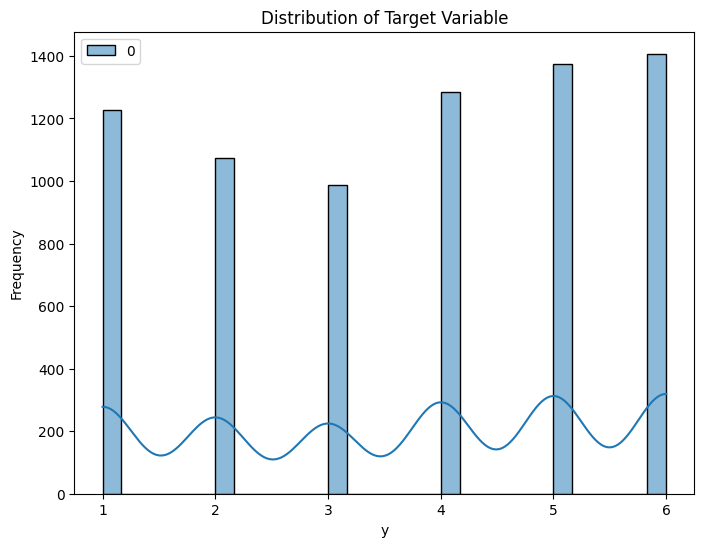

In [12]:
plt.figure(figsize=(8, 6))
sns.histplot(y, bins=30, kde=True, color='blue')
plt.title('Distribution of Target Variable')
plt.xlabel('y')
plt.ylabel('Frequency')
plt.show()

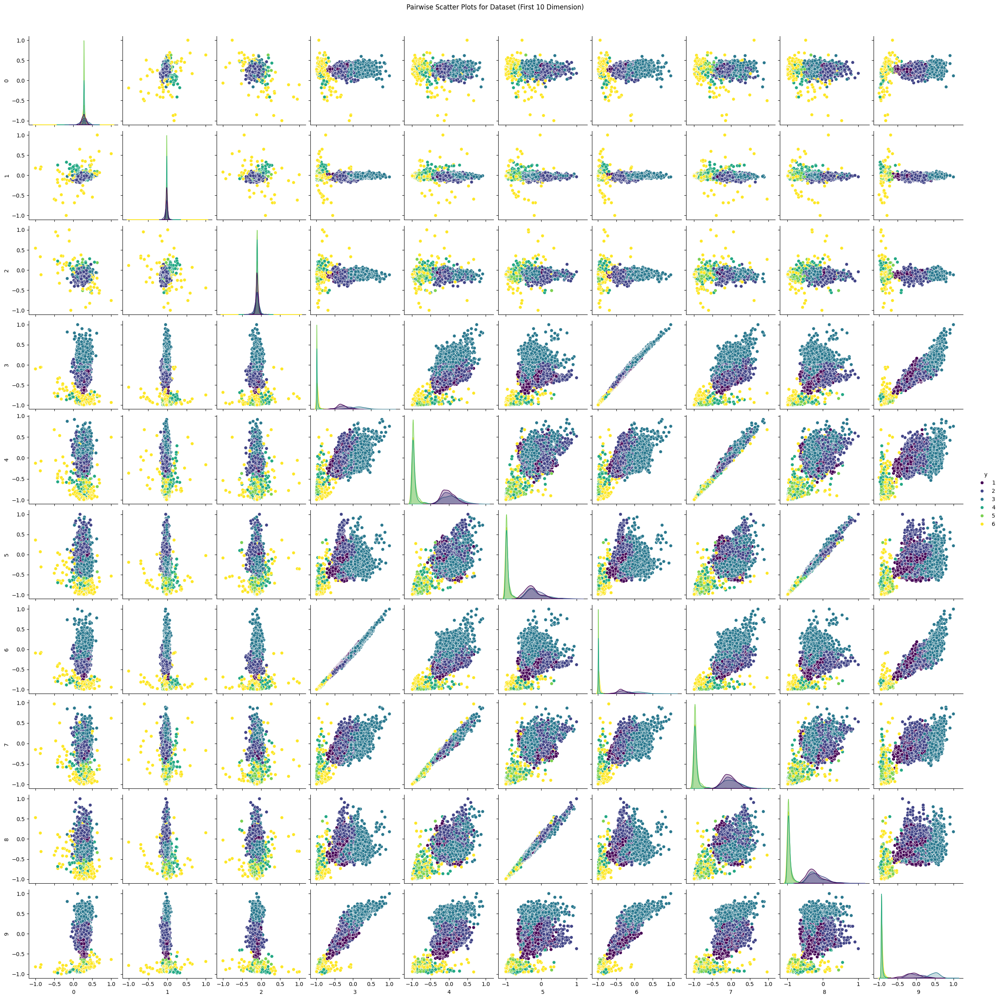

In [13]:
first_10 = X.columns[:10]
df_visualize = pd.DataFrame(data=df.iloc[:, :10], columns=first_10)

df_visualize['y'] = y

sns.pairplot(df_visualize, hue='y', palette='viridis', markers='o', diag_kind='kde')
plt.suptitle('Pairwise Scatter Plots for Dataset (First 10 Dimension)', y=1.02)
plt.show()

# Modeling 

+ Build K-Means and DBSCAN clusting
+ Build K-Means and DBSCAN clusting using dimensionality reduction
+ Cluster Visualization


In [14]:
Q1, Q3 = X.quantile(0.01), X.quantile(0.99)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

lower_bound, upper_bound = lower_bound.align(upper_bound, axis=0, copy=False)


outliers_mask_iqr = ((X < lower_bound) | (X > upper_bound)).any(axis=1)

df_no_outliers_iqr = df[~outliers_mask_iqr]

X = df_no_outliers_iqr

In [15]:
X.shape

(7186, 562)

## Without dimensionality reduction

### K-Means

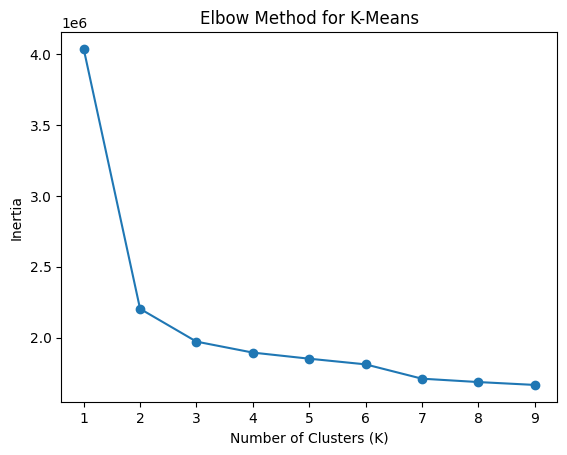

In [16]:
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.neighbors import NearestNeighbors

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

inertia_values = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_scaled)
    inertia_values.append(kmeans.inertia_)

plt.plot(range(1, 10), inertia_values, marker='o')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Inertia')
plt.title('Elbow Method for K-Means')
plt.show()

In [17]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

kmeans = KMeans(n_clusters=6, random_state=42)
kmeans_clusters = kmeans.fit_predict(X_scaled, y)
kmeans_clusters += 1

kmeans_clusters_perf_without_PCA = kmeans_clusters

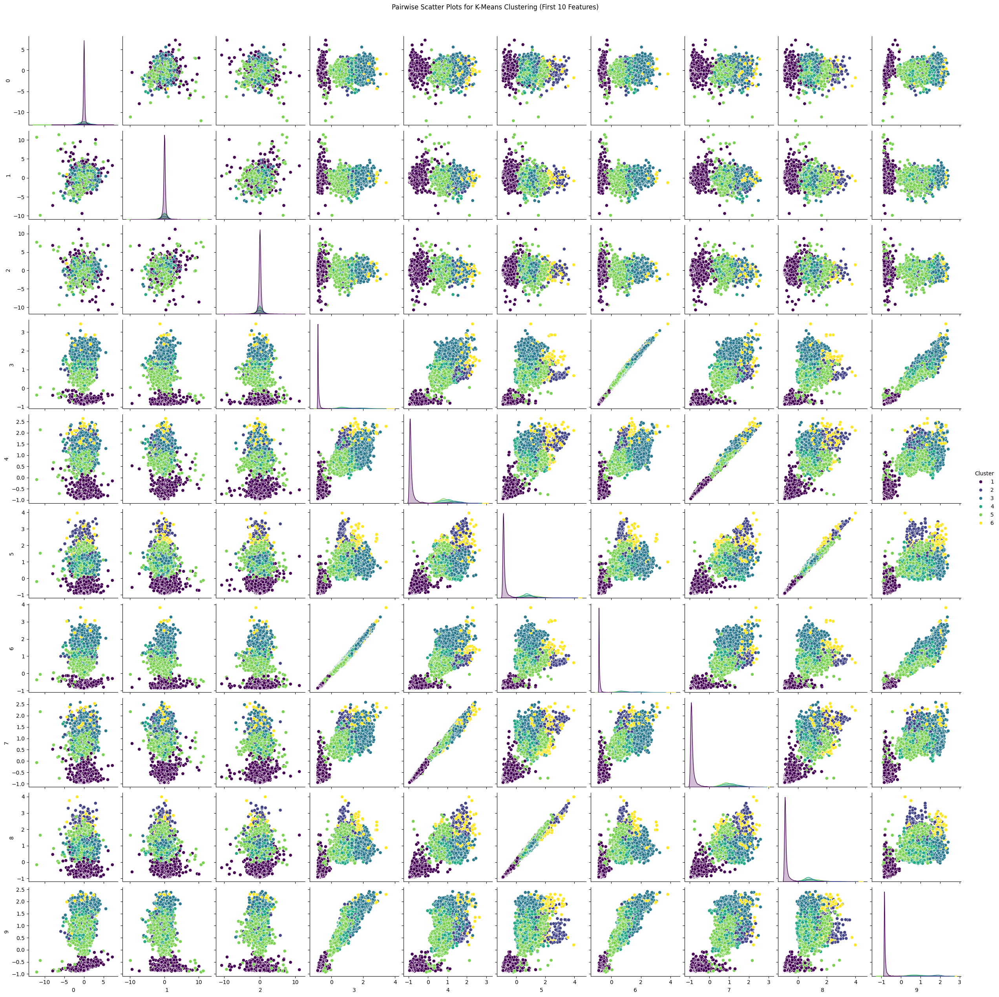

In [18]:
first_10 = df.columns[:10]


df_visualize = pd.DataFrame(data=X_scaled[:, :10], columns=first_10)
df_visualize['Cluster'] = kmeans_clusters

sns.pairplot(df_visualize, hue='Cluster', palette='viridis', markers='o', diag_kind='kde')
plt.suptitle('Pairwise Scatter Plots for K-Means Clustering (First 10 Features)', y=1.02)
plt.show()

### DBSCAN

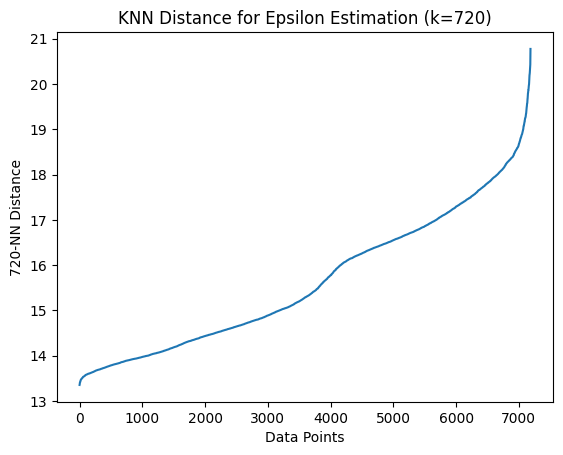

In [19]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

k = 720  
nbrs = NearestNeighbors(n_neighbors=k, metric='euclidean')
nbrs.fit(X_scaled)
distances, _ = nbrs.kneighbors(X)

sorted_distances = np.sort(distances[:, -1])
plt.plot(np.arange(len(sorted_distances)), sorted_distances)
plt.xlabel('Data Points')
plt.ylabel(f'{k}-NN Distance')
plt.title(f'KNN Distance for Epsilon Estimation (k={k})')
plt.show()


In [20]:
dbscan = DBSCAN(eps=17.4, min_samples=4) 
labels = dbscan.fit_predict(X_scaled)
labels += 1

dbscan_clusters_perf_without_PCA = labels

num_clusters = len(set(labels)) - (1 if -1 in labels else 0) 
print(f'Number of clusters: {num_clusters}')
print(f'Cluster assignments: {labels}')
unique_clusters = set(labels)
print(f'Distinct clusters: {unique_clusters}')

labels_replaced = [len(unique_clusters) + 1 if label == -1 else label for label in labels]


label_counts = np.bincount(labels_replaced)

for label, count in enumerate(label_counts):
    noise = ""
    if label == 0:
        noise = "noisely label"
    print(f"Label {label} {noise}: {count} occurrences")
    
print(silhouette_score(X, dbscan_clusters_perf_without_PCA))

Number of clusters: 7
Cluster assignments: [1 1 1 ... 1 1 1]
Distinct clusters: {0, 1, 2, 3, 4, 5, 6}
Label 0 noisely label: 707 occurrences
Label 1 : 6389 occurrences
Label 2 : 13 occurrences
Label 3 : 10 occurrences
Label 4 : 33 occurrences
Label 5 : 31 occurrences
Label 6 : 3 occurrences
-0.1653312549518636


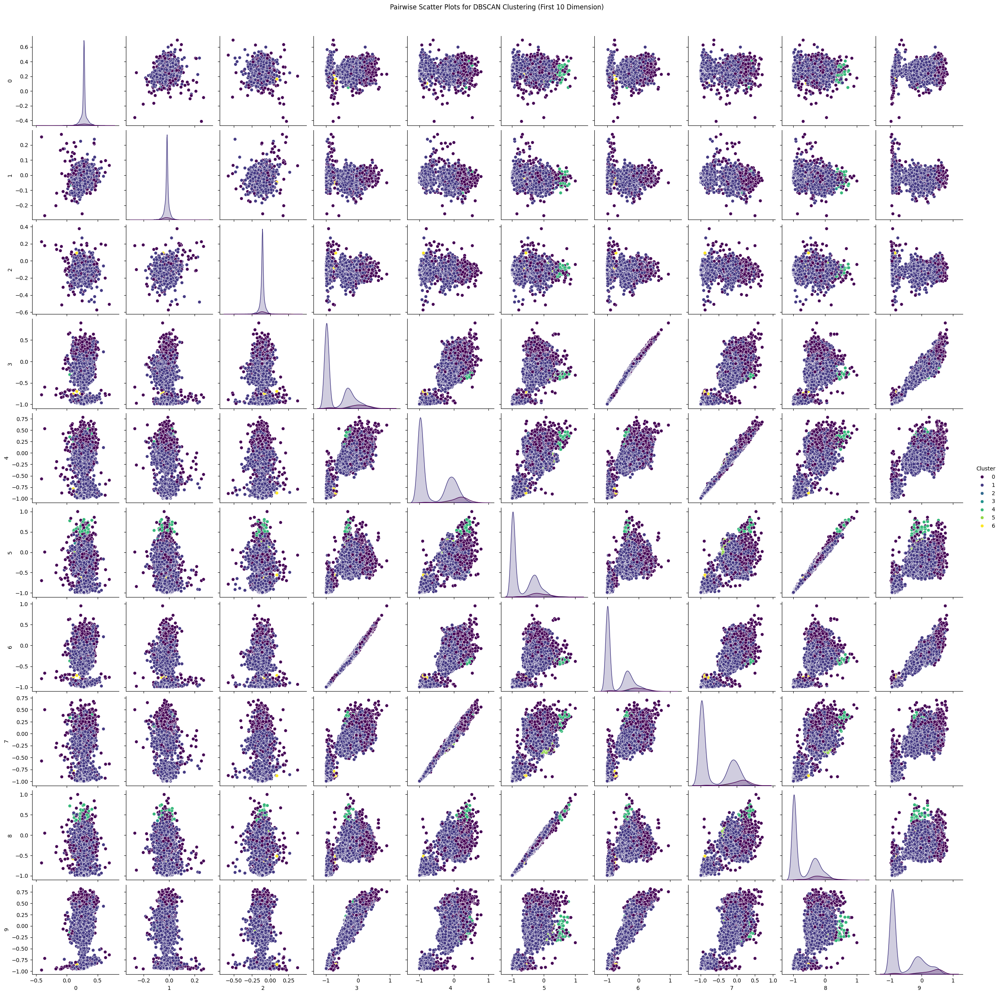

In [21]:
data = pd.DataFrame(data=X)
df_visualize = pd.DataFrame(data=data.iloc[:, :10])
df_visualize['Cluster'] = labels

sns.pairplot(df_visualize, hue='Cluster', palette='viridis', markers='o', diag_kind='kde')
plt.suptitle('Pairwise Scatter Plots for DBSCAN Clustering (First 10 Dimension)', y=1.02)
plt.show()

## With dimensionality reduction

### PCA

[0.51772573 0.58010454 0.60613242 0.6309498  0.64916969 0.66621751
 0.67939703 0.69099323 0.70084456 0.70998982]
[0.51772573 0.58010454 0.60613242 0.6309498  0.64916969 0.66621751
 0.67939703 0.69099323 0.70084456 0.70998982]
Cumulative Explained Variance Ratio:
[0.51772573 0.58010454 0.60613242 0.6309498  0.64916969 0.66621751
 0.67939703 0.69099323 0.70084456 0.70998982]

Number of components for 70.0% variance: 9


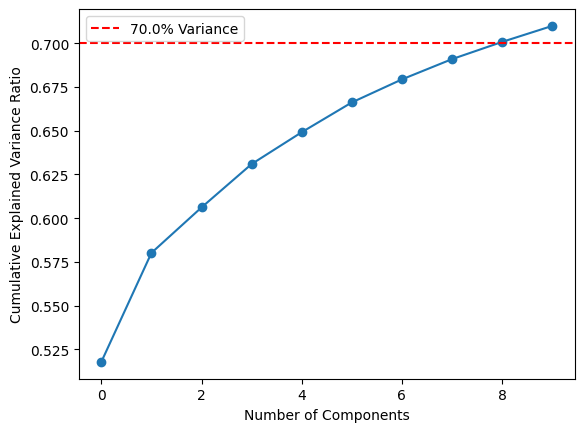

In [22]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, DBSCAN
import matplotlib.pyplot as plt


scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)


pca = PCA(n_components=10)
X_pca = pca.fit_transform(X_scaled, y)

cumulative_variance_ratio = np.cumsum(pca.explained_variance_ratio_)
print(cumulative_variance_ratio)

threshold = 0.70
num_components_threshold = np.argmax(cumulative_variance_ratio >= threshold) + 1

cumulative_variance_ratio = np.cumsum(pca.explained_variance_ratio_)
print(cumulative_variance_ratio)

print("Cumulative Explained Variance Ratio:")
print(cumulative_variance_ratio)
print(f"\nNumber of components for {threshold * 100}% variance: {num_components_threshold}")

plt.plot(cumulative_variance_ratio, marker='o')
plt.axhline(y=threshold, color='r', linestyle='--', label=f'{threshold * 100}% Variance')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.legend()
plt.show()

### K-Means

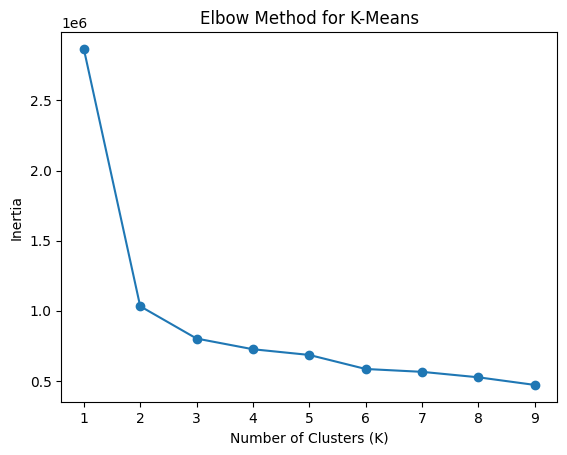

In [23]:
inertia_values = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_pca)
    inertia_values.append(kmeans.inertia_)

plt.plot(range(1, 10), inertia_values, marker='o')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Inertia')
plt.title('Elbow Method for K-Means')
plt.show()

In [24]:
# can use 5/6 as optimal cluster from above image

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

kmeans = KMeans(n_clusters=6, random_state=42)
kmeans_clusters = kmeans.fit_predict(X_scaled, y)
kmeans_clusters += 1

kmeans_clusters_perf_with_PCA = kmeans_clusters

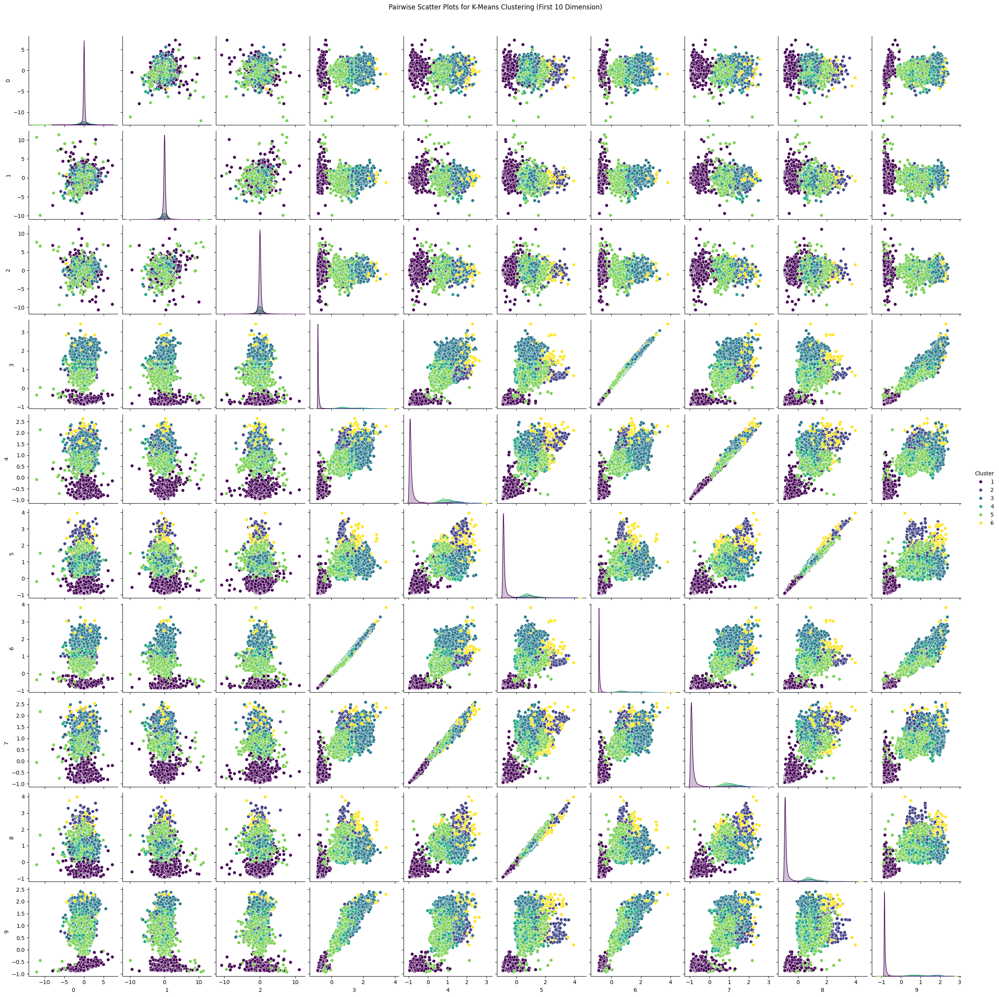

In [25]:
first_10 = df.columns[:10]


df_visualize = pd.DataFrame(data=X_scaled[:, :10], columns=first_10)
df_visualize['Cluster'] = kmeans_clusters

sns.pairplot(df_visualize, hue='Cluster', palette='viridis', markers='o', diag_kind='kde')
plt.suptitle('Pairwise Scatter Plots for K-Means Clustering (First 10 Dimension)', y=1.02)
plt.show()

### DBSCAN

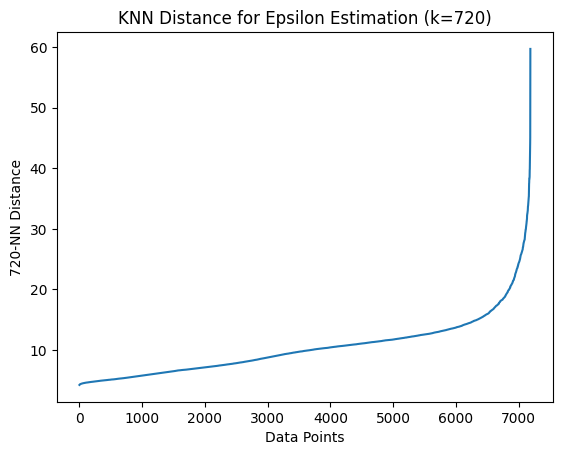

In [26]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors

k = 720  

nbrs = NearestNeighbors(n_neighbors=k, metric='euclidean')
nbrs.fit(X_pca)
distances, _ = nbrs.kneighbors(X_pca)

sorted_distances = np.sort(distances[:, -1])
plt.plot(np.arange(len(sorted_distances)), sorted_distances)
plt.xlabel('Data Points')
plt.ylabel(f'{k}-NN Distance')
plt.title(f'KNN Distance for Epsilon Estimation (k={k})')
plt.show()


In [27]:
# dbscan = DBSCAN(eps=1.5, min_samples=20) 
dbscan = DBSCAN(eps=6.3, min_samples=7) 
labels = dbscan.fit_predict(X_pca, y)
labels += 1

dbscan_clusters_perf_with_PCA = labels

num_clusters = len(set(labels)) - (1 if -1 in labels else 0) 
print(f'Number of clusters: {num_clusters}')
print(f'Cluster assignments: {labels}')
unique_clusters = set(labels)
print(f'Distinct clusters: {unique_clusters}')

labels_replaced = [len(unique_clusters) + 1 if label == -1 else label for label in labels]


label_counts = np.bincount(labels_replaced)

for label, count in enumerate(label_counts):
    noise = ""
    if label == 0:
        noise = "noisely label"
    print(f"Label {label} {noise}: {count} occurrences")

print(silhouette_score(X_pca, dbscan_clusters_perf_with_PCA))

Number of clusters: 6
Cluster assignments: [1 1 1 ... 2 2 2]
Distinct clusters: {0, 1, 2, 3, 4, 5}
Label 0 noisely label: 240 occurrences
Label 1 : 3984 occurrences
Label 2 : 2904 occurrences
Label 3 : 6 occurrences
Label 4 : 7 occurrences
Label 5 : 45 occurrences
0.4136136844027619


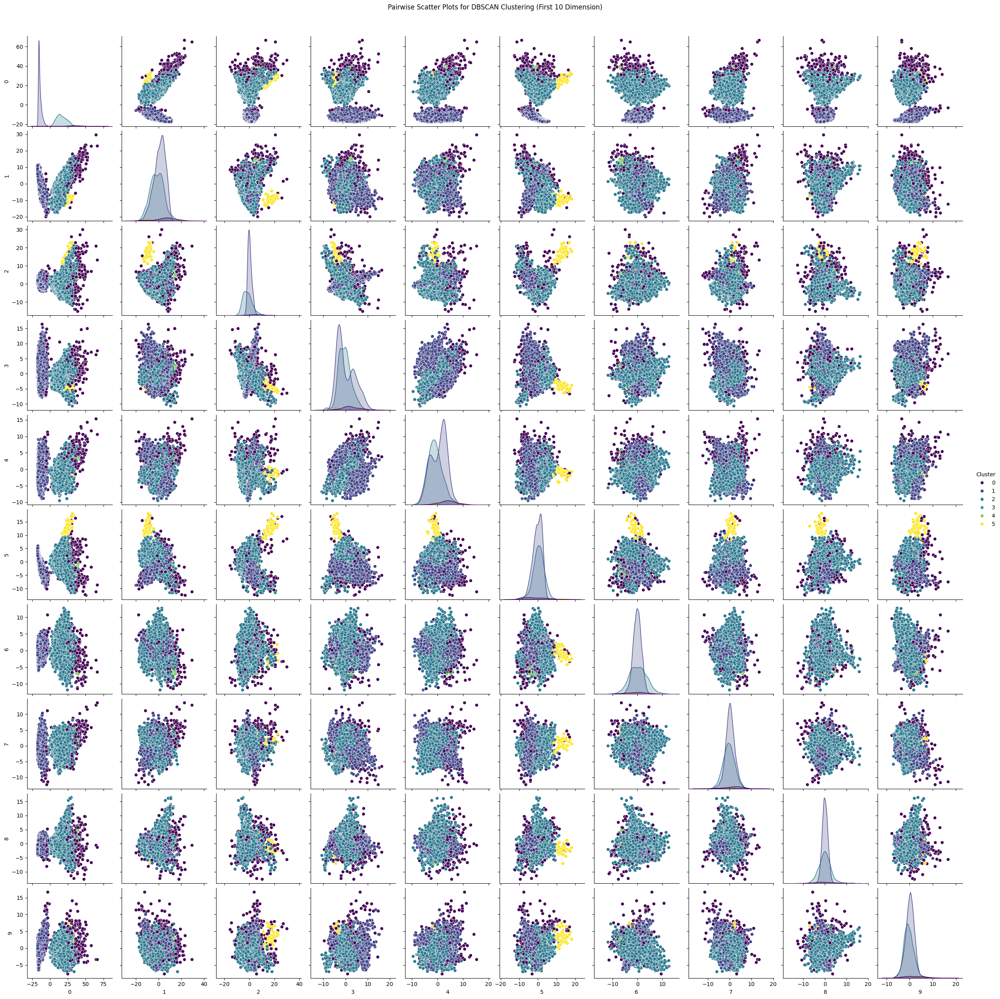

In [28]:
data = pd.DataFrame(data=X_pca)
df_visualize = pd.DataFrame(data=data.iloc[:, :10])
df_visualize['Cluster'] = labels

sns.pairplot(df_visualize, hue='Cluster', palette='viridis', markers='o', diag_kind='kde')
plt.suptitle('Pairwise Scatter Plots for DBSCAN Clustering (First 10 Dimension)', y=1.02)
plt.show()

## Performance Comparision 

### K-Means

In [29]:
from sklearn.metrics import silhouette_score, davies_bouldin_score

silhouette_kmeans_without_pca = silhouette_score(X, kmeans_clusters_perf_without_PCA)
davies_bouldin_kmeans_without_pca = davies_bouldin_score(X, kmeans_clusters_perf_without_PCA)

print(f' K-Means without PCA silhouette:{silhouette_kmeans_without_pca} davies_bouldin:{davies_bouldin_kmeans_without_pca}')

silhouette_kmeans_with_pca = silhouette_score(X_pca, kmeans_clusters_perf_with_PCA)
davies_bouldin_kmeans_with_pca = davies_bouldin_score(X_pca, kmeans_clusters_perf_with_PCA)

print(f' K-Means with PCA silhouette:{silhouette_kmeans_with_pca} davies_bouldin:{davies_bouldin_kmeans_with_pca}')

 K-Means without PCA silhouette:0.29079848199169944 davies_bouldin:2.250499049207088
 K-Means with PCA silhouette:0.4088428768264146 davies_bouldin:1.2998286479747767


### DBSCAN

In [30]:
from sklearn.metrics import silhouette_score, davies_bouldin_score

silhouette_dbscan_without_pca = silhouette_score(X, dbscan_clusters_perf_without_PCA)
davies_bouldin_dbscan_without_pca = davies_bouldin_score(X, dbscan_clusters_perf_without_PCA)

print(f' DBSCAN without PCA silhouette:{silhouette_dbscan_without_pca} davies_bouldin:{davies_bouldin_dbscan_without_pca}')

silhouette_dbscan_with_pca = silhouette_score(X_pca, dbscan_clusters_perf_with_PCA)
davies_bouldin_dbscan_with_pca = davies_bouldin_score(X_pca, dbscan_clusters_perf_with_PCA)

print(f' DBSCAN PCA silhouette:{silhouette_dbscan_with_pca} davies_bouldin:{davies_bouldin_dbscan_without_pca}')

 DBSCAN without PCA silhouette:-0.1653312549518636 davies_bouldin:1.8814578834729263
 DBSCAN PCA silhouette:0.4136136844027619 davies_bouldin:1.8814578834729263


### Performance Graph

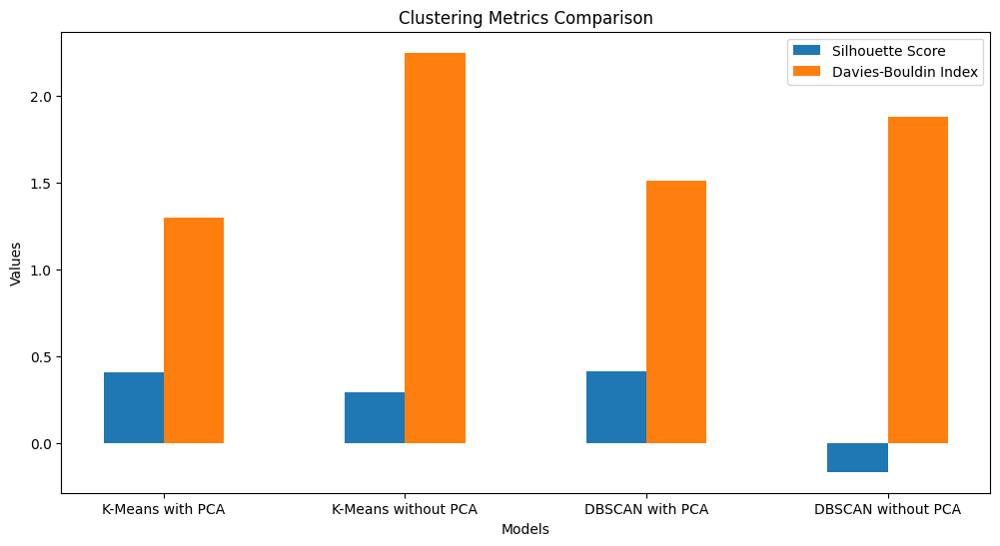

In [31]:
import matplotlib.pyplot as plt
import numpy as np

silhouette_scores = [silhouette_kmeans_with_pca, silhouette_kmeans_without_pca,
                      silhouette_dbscan_with_pca, silhouette_dbscan_without_pca]
davies_bouldin_scores = [davies_bouldin_kmeans_with_pca, davies_bouldin_kmeans_without_pca,
                         davies_bouldin_dbscan_with_pca, davies_bouldin_dbscan_without_pca]

models = ['K-Means with PCA', 'K-Means without PCA', 'DBSCAN with PCA', 'DBSCAN without PCA']

fig, ax = plt.subplots(figsize=(12, 6))

bar_width = 0.25
index = np.arange(len(models))

bar1 = ax.bar(index, silhouette_scores, bar_width, label='Silhouette Score')
bar2 = ax.bar(index + bar_width, davies_bouldin_scores, bar_width, label='Davies-Bouldin Index')

ax.set_xlabel('Models')
ax.set_ylabel('Values')
ax.set_title('Clustering Metrics Comparison')
ax.set_xticks(index + bar_width / 2)
ax.set_xticklabels(models)
ax.legend()

# Show the plot
plt.show()
